Metrics

In [1]:
# import geopandas as gpd
import numpy as np
import pandas as pd
import pygmt
# import matplotlib.pyplot as plt

def Gfit(obs, pred, t = 0.1): #a normalized least-squares using threshold t
    obs = np.array(obs)
    pred = np.array(pred)
    #set values below threshold to 0
    obs[obs < t] = 0
    pred[pred < t] = 0
    #calculate the G value
    Gvalue = 1 - (2*np.sum(obs*pred)/(np.sum(obs**2)+np.sum(pred**2)))
    return Gvalue

def AQC(obs, pred,t = 0.1): #Accuracy score based on threshold t
    obs = np.array(obs)
    pred = np.array(pred)
    #set values below threshold to 0
    obs[obs < t] = 0
    pred[pred < t] = 0
    #set values above threshold to 1
    obs[obs >= t] = 1
    pred[pred >= t] = 1
    #calculate the accuracy value
    aqc = np.sum(obs == pred)/len(obs)
    return aqc


Matplotlib created a temporary cache directory at /tmp/matplotlib-2tcrbmk_ because the default path (/home/naveen.raguramalinga/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


Historic Events

RIKU


In [2]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def plot_map(gauge, fold,epoch, region):

    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    print('his_data size is {}'.format(his_data.shape))

    hist_name_list = ['FUJI2011_42','SANRIKU1896','SANRIKU1933','TOKACHI1968','YAMAZAKI2018_TPMOD']   
    neve = len(hist_name_list)
    print('Events plotting are {}'.format(hist_name_list))
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
        zooml = 12
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
        zooml = 10
    elif gauge == '3GaugeShio':
        site = 'Sendai'
        subsize = ["10c","20c"]
        zooml = 5

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t1c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "0.5c"],
        frame = ["ag"],
        ):
        # Plot each event
        for i in range(neve):    
            # Get data for the event
            event = hist_name_list[i]
            print('event is {}'.format(event))
            for k in fold:
                predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_output/vae_riku_test_{event}_k{k}_e{epoch:04d}.npy'
                predict_k = np.load(predict_path)
                if k == 0:
                    predict = predict_k
                else:
                    predict = np.append(predict,predict_k, axis=0)

            print('predict size is {}'.format(predict.shape))

            eve_data = his_data[hist_name_list[i]].squeeze()
            mean = np.mean(predict, axis=0).squeeze()
            std2 = 2 * np.std(predict, axis=0).squeeze()
            
            # Set the color range for the plot, threshold mask
            colorend = max(eve_data.max(), mean.max())
            mask = ((eve_data > 0.1) | (mean > 0.1))
            
            # Plot observed data
            with fig.set_panel(panel=[i,0]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = eve_data 
                print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                            frame = ["+t{}".format(event)],        
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/1.5c+h")

            with fig.set_panel(panel=[i,1]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = mean
                print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/1.5c+h")

            with fig.set_panel(panel=[i,2]):
                para = eve_data - mean
                print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/1.5c+h")
                fig.text(position='TC',offset= "j0c/2c", justify="CT",
                        text=f'G: {Gfit(eve_data, mean):.3f}, A: {AQC(eve_data, mean):.2f}',
                        font="25p,Helvetica-Bold,Yellow")

            with fig.set_panel(panel=[i,3]):
                para = eve_data - mean - std2
                print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/1.5c+h")
                fig.text(position='TC',offset= "j0c/2c", justify="CT",
                        text=f'G: {Gfit(eve_data, mean - std2):.3f}, A: {AQC(eve_data, mean - std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")

            with fig.set_panel(panel=[i,4]):
                para = eve_data - mean + std2
                print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10])
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            )
                fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/1.5c+h")
                fig.text(position='TC',offset= "j0c/2c", justify="CT",
                        text=f'G: {Gfit(eve_data, mean + std2):.3f}, A: {AQC(eve_data, mean + std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                 
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}_hist.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
plot_map(gauge = g_list[0], fold = [0,1,2,3,4],epoch = 0,region = 3)


his_data size is (6648, 13)
Events plotting are ['FUJI2011_42', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD']
event is FUJI2011_42
predict size is (500, 6648)
range of observed data is max 14.79318 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 14.959411094665528 min -0.0018775029664975591


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 5.5358789364433285 min -2.892027669525147


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 5.06028241208222 min -4.211139254757312


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 6.082689478253904 min -2.156390239589384


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


event is SANRIKU1896
predict size is (500, 6648)
range of observed data is max 4.58024 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 2.6859168419837953 min -0.054697072343202306


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 2.572997550840378 min -0.9961149368047714


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 2.2177379900921004 min -1.1749325816763678


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 2.928257111588656 min -0.8172972919331748


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


event is SANRIKU1933
predict size is (500, 6648)
range of observed data is max 7.99549 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 5.7497140417098995 min -0.13204975850507616


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 4.439448820514679 min -2.624296036987305


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 3.9200571796220443 min -3.194532854658875


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 4.958840461407314 min -2.0549763251509607


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


event is TOKACHI1968
predict size is (500, 6648)
range of observed data is max 3.44972 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 1.4504841847419738 min -0.04103603561874479


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 2.3542270707726476 min -0.09337714475020767


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 2.137052255851107 min -0.2733232349538633


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 2.571401885694188 min 1.762565497456999e-08


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


event is YAMAZAKI2018_TPMOD
predict size is (500, 6648)
range of observed data is max 12.6295 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean predicted data is max 11.60977791595459 min -0.0007304290196442575


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of mean misfit is max 4.027845712928771 min -1.9737441039085388


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of -2std misfit is max 3.3325173846140563 min -2.3049699885277164


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


range of +2std misfit is max 4.723174041243486 min -1.642518219289361


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.58023 to 141.580085616
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.69967 to 141.699846247
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.95023 to 38.9501669279
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 39.04988 to 39.0499161427


ISHI

In [4]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def plot_map(gauge, fold,epoch, region):

    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    print('his_data size is {}'.format(his_data.shape))

    hist_name_list = ['FUJI2011_42','SANRIKU1896','SANRIKU1933','TOKACHI1968','YAMAZAKI2018_TPMOD']   
    neve = len(hist_name_list)
    print('Events plotting are {}'.format(hist_name_list))
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
        zooml = 12
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
        zooml = 10
    elif gauge == '3GaugeShio':
        site = 'Sendai'
        subsize = ["10c","20c"]

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "1.5c"],
        frame = ["ag"],
        ):
        # Plot each event
        for i in range(neve):    
            # Get data for the event
            event = hist_name_list[i]
            print('event is {}'.format(event))
            for k in fold:
                predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_output/vae_riku_test_{event}_k{k}_e{epoch:04d}.npy'
                predict_k = np.load(predict_path)
                if k == 0:
                    predict = predict_k
                else:
                    predict = np.append(predict,predict_k, axis=0)
            print('predict size is {}'.format(predict.shape))

            eve_data = his_data[hist_name_list[i]].squeeze()
            mean = np.mean(predict, axis=0).squeeze()
            std2 = 2 * np.std(predict, axis=0).squeeze()
            
            # Set the color range for the plot, threshold mask
            colorend = max(eve_data.max(), mean.max())
            mask = ((eve_data > 0.1) | (mean > 0.1))
        
            
            # Plot observed data
            with fig.set_panel(panel=[i,0]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = eve_data 
                print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                            frame = ["+t{}".format(event)],
                        
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/1c+h")

            with fig.set_panel(panel=[i,1]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = mean
                print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/1c+h")

            with fig.set_panel(panel=[i,2]):
                para = eve_data - mean
                print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/1c+h")
                fig.text(position='BC',offset= "j0c/1c", justify="CB",
                        text=f'G: {Gfit(eve_data, mean):.3f}, A: {AQC(eve_data, mean):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                        
            with fig.set_panel(panel=[i,3]):
                para = eve_data - mean - std2
                print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/1c+h")
                fig.text(position='BC',offset= "j0c/1c", justify="CB",
                        text=f'G: {Gfit(eve_data, mean - std2):.3f}, A: {AQC(eve_data, mean - std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                
            with fig.set_panel(panel=[i,4]):
                para = eve_data - mean + std2
                print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/10]) 
                fig.tilemap(
                            region=region,
                            projection="M12c",
                            zoom=12,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.15c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M12c",
                            )
                fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/1c+h")
                fig.text(position='BC',offset= "j0c/1c", justify="CB",
                        text=f'G: {Gfit(eve_data, mean + std2):.3f}, A: {AQC(eve_data, mean + std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}_hist.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
plot_map(gauge = g_list[1], fold = [0,1,2,3,4],epoch = 0,region = 2)


his_data size is (54671, 13)
Events plotting are ['FUJI2011_42', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD']
event is FUJI2011_42
predict size is (500, 54671)
range of observed data is max 11.54539 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 11.070549327850342 min -0.341608310200274


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 5.979832659783364 min -2.2061174390411367


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 5.610110282712867 min -3.4227429051164218


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 6.634290163689727 min -1.1488537910792107


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


event is SANRIKU1896
predict size is (500, 54671)
range of observed data is max 0.77984 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 0.9332549332380294 min -0.2735642579942942


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 0.2735642579942942 min -0.5515270892381668


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 0.12457060693305966 min -0.6916465246692107


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 0.4225579090555287 min -0.41140765380712296


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


event is SANRIKU1933
predict size is (500, 54671)
range of observed data is max 1.93368 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 2.1210761544704435 min -0.17407257670164109


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 0.1827150536489487 min -0.775182898774147


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 0.075987517664147 min -0.9466090782939516


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 0.4560513267936457 min -0.6037567192543425


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


event is TOKACHI1968
predict size is (500, 54671)
range of observed data is max 1.28362 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 1.1621768296957016 min -0.1152538402993232


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 0.1275148407459259 min -0.5317216183376312


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max -1.1171933097354223e-10 min -0.7093198183928815


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 0.32480188914000097 min -0.35792948054326545


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


event is YAMAZAKI2018_TPMOD
predict size is (500, 54671)
range of observed data is max 7.64332 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean predicted data is max 8.13390042591095 min -0.02199701591953635


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of mean misfit is max 2.2907028689193725 min -1.652380304336548


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of -2std misfit is max 2.101853111072466 min -2.3653610935506943


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


range of +2std misfit is max 2.5861275834585786 min -1.2850659021902884


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 141.13022 to 141.130038401
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.39997 to 141.400167355
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 38.34023 to 38.340223334
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.49972 to 38.4998309556


SENDAI

his_data size is (129941, 13)
Events plotting are ['FUJI2011_42', 'YAMAZAKI2018_TPMOD']
event is FUJI2011_42
predict size is (500, 129941)
range of observed data is max 12.34018 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 12.58358257484436 min -0.001233703500006942


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 6.4268948406982425 min -1.908642561721802


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 6.1665749594114265 min -2.552601019298181


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 6.808140043940659 min -1.3492842769090927


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


event is YAMAZAKI2018_TPMOD
predict size is (500, 129941)
range of observed data is max 13.7344 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 13.011089698791505 min -0.0010667914140425568


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 5.550640781087875 min -1.9312284020996087


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 5.172603160361351 min -2.8935938233254896


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 5.928678401814398 min -1.5707102582377341


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


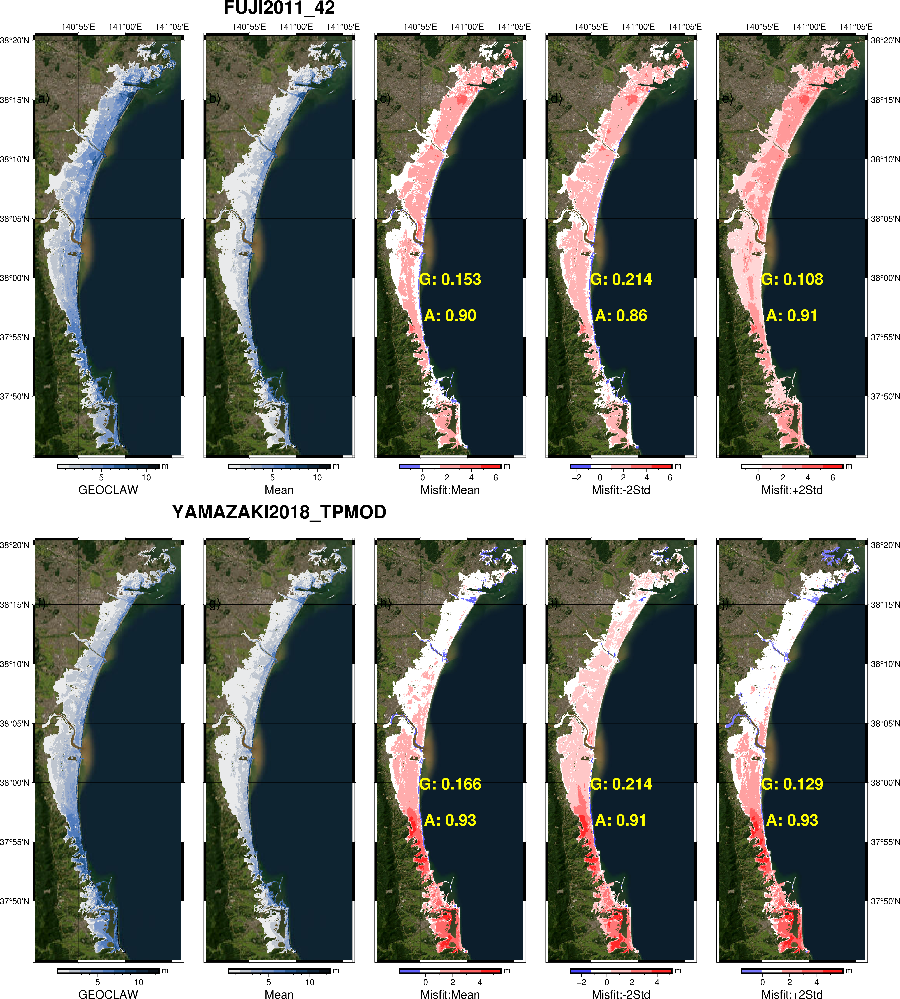

In [2]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def plot_map(gauge, fold,epoch, region):

    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    print('his_data size is {}'.format(his_data.shape))

    # hist_name_list = ['FUJI2011_42','SANRIKU1896','SANRIKU1933','TOKACHI1968','YAMAZAKI2018_TPMOD']   
    hist_name_list = ['FUJI2011_42','YAMAZAKI2018_TPMOD']   
    neve = len(hist_name_list)
    print('Events plotting are {}'.format(hist_name_list))
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
    elif gauge == '3GaugeShio':
        site = 'Sendai'
        subsize = ["8c","20c"]

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "3c"],
        frame = ["ag"],
        ):
         # Plot each event
        for i in range(neve):    
            # Get data for the event
            event = hist_name_list[i]
            print('event is {}'.format(event))
            for k in fold:
                predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_output/vae_riku_test_{event}_k{k}_e{epoch:04d}.npy'
                predict_k = np.load(predict_path)
                if k == 0:
                    predict = predict_k
                else:
                    predict = np.append(predict,predict_k, axis=0)
            print('predict size is {}'.format(predict.shape))

            eve_data = his_data[hist_name_list[i]].squeeze()
            mean = np.mean(predict, axis=0).squeeze()
            std2 = 2 * np.std(predict, axis=0).squeeze()
            
            # Set the color range for the plot, threshold mask
            colorend = max(eve_data.max(), mean.max())
            mask = ((eve_data > 0.1) | (mean > 0.1))
            
            # Plot observed data
            with fig.set_panel(panel=[i,0]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = eve_data 
                print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,                       
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,1]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = mean
                print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,
                            frame = ["+t{}".format(event)],
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,2]):
                para = eve_data - mean
                print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                    
            with fig.set_panel(panel=[i,3]):
                para = eve_data - mean - std2
                print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean - std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean - std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                
            with fig.set_panel(panel=[i,4]):
                para = eve_data - mean + std2
                print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            )
                fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean + std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean + std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}_hist.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
plot_map(gauge = g_list[2], fold = [0,1,2,3,4],epoch = 0,region = 1)


his_data size is (129941, 13)
Events plotting are ['SANRIKU1896', 'SANRIKU1933']
event is SANRIKU1896
predict size is (500, 129941)
range of observed data is max 2.6138 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 1.707420488357544 min -0.057221285986248406


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 1.630957229704857 min -0.7246019403934478


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 1.5170285752950259 min -0.8524789422247291


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 1.744885884114688 min -0.5967249385621666


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


event is SANRIKU1933
predict size is (500, 129941)
range of observed data is max 3.08243 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 2.8772218842506407 min -0.11197296491079033


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 1.405284046602249 min -0.9488213573694229


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 1.2952710466968893 min -1.102587878011935


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 1.5152970465076085 min -0.7950548367269108


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


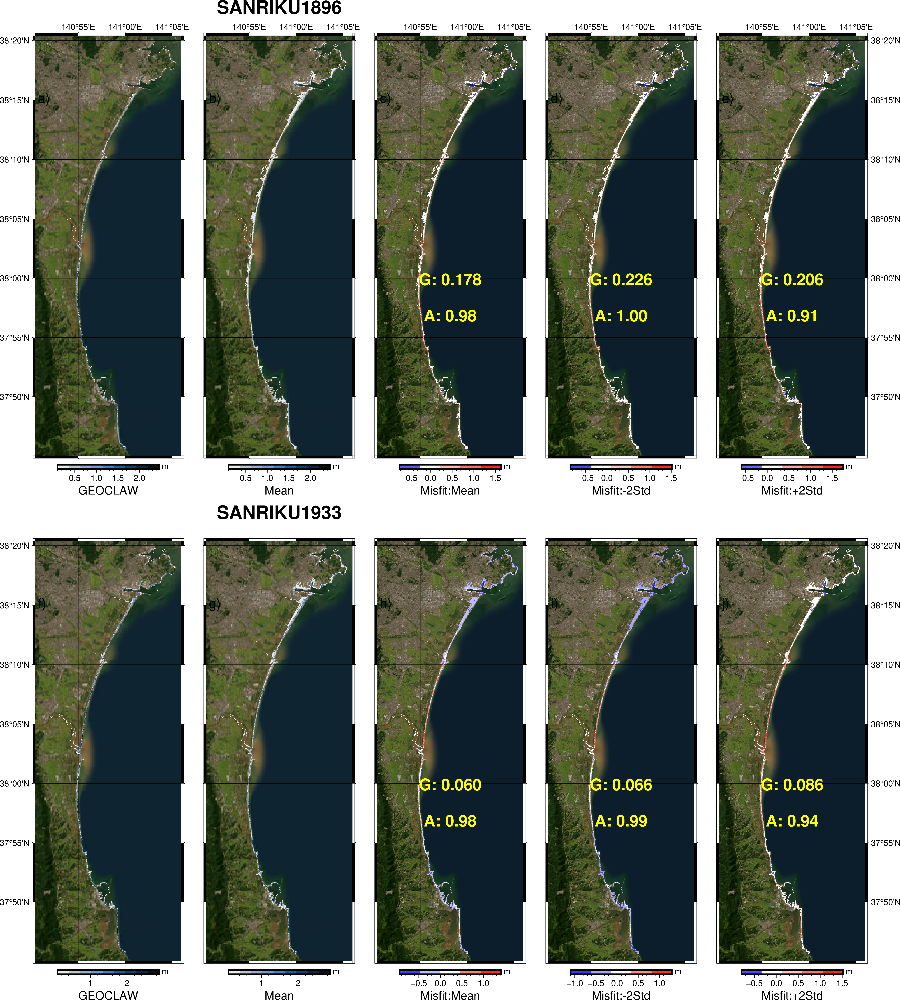

In [2]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def plot_map(gauge, fold,epoch, region):

    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    print('his_data size is {}'.format(his_data.shape))

    # hist_name_list = ['FUJI2011_42','SANRIKU1896','SANRIKU1933','TOKACHI1968','YAMAZAKI2018_TPMOD']   
    hist_name_list = ['SANRIKU1896','SANRIKU1933']   
    neve = len(hist_name_list)
    print('Events plotting are {}'.format(hist_name_list))
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
    elif gauge == '3GaugeShio':
        site = 'Sendai'
        subsize = ["8c","20c"]

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "3c"],
        frame = ["ag"],
        ):
         # Plot each event
        for i in range(neve):    
            # Get data for the event
            event = hist_name_list[i]
            print('event is {}'.format(event))
            for k in fold:
                predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_output/vae_riku_test_{event}_k{k}_e{epoch:04d}.npy'
                predict_k = np.load(predict_path)
                if k == 0:
                    predict = predict_k
                else:
                    predict = np.append(predict,predict_k, axis=0)
            print('predict size is {}'.format(predict.shape))

            eve_data = his_data[hist_name_list[i]].squeeze()
            mean = np.mean(predict, axis=0).squeeze()
            std2 = 2 * np.std(predict, axis=0).squeeze()
            
            # Set the color range for the plot, threshold mask
            colorend = max(eve_data.max(), mean.max())
            mask = ((eve_data > 0.1) | (mean > 0.1))
            
            # Plot observed data
            with fig.set_panel(panel=[i,0]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = eve_data 
                print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,                       
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,1]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = mean
                print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,
                            frame = ["+t{}".format(event)],
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,2]):
                para = eve_data - mean
                print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                    
            with fig.set_panel(panel=[i,3]):
                para = eve_data - mean - std2
                print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean - std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean - std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                
            with fig.set_panel(panel=[i,4]):
                para = eve_data - mean + std2
                print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            )
                fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean + std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean + std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}_hist1.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
plot_map(gauge = g_list[2], fold = [0,1,2,3,4],epoch = 0,region = 1)


his_data size is (129941, 13)
Events plotting are ['TOKACHI1968']
event is TOKACHI1968
predict size is (500, 129941)
range of observed data is max 1.01659 min 0.0


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean predicted data is max 1.4384328050613404 min -0.1027629284914583


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839074898
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099858404
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.7498323964
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3410203441


range of mean misfit is max 0.11029172372817997 min -0.6880418131828309


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of -2std misfit is max 0.007532411622644522 min -0.8194099889172448


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


range of +2std misfit is max 0.29696522515813645 min -0.5566736374484169


grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from 140.84022 to 140.839887649
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from 141.09963 to 141.099696666
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 37.75022 to 37.749751608
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 38.33993 to 38.3403803507


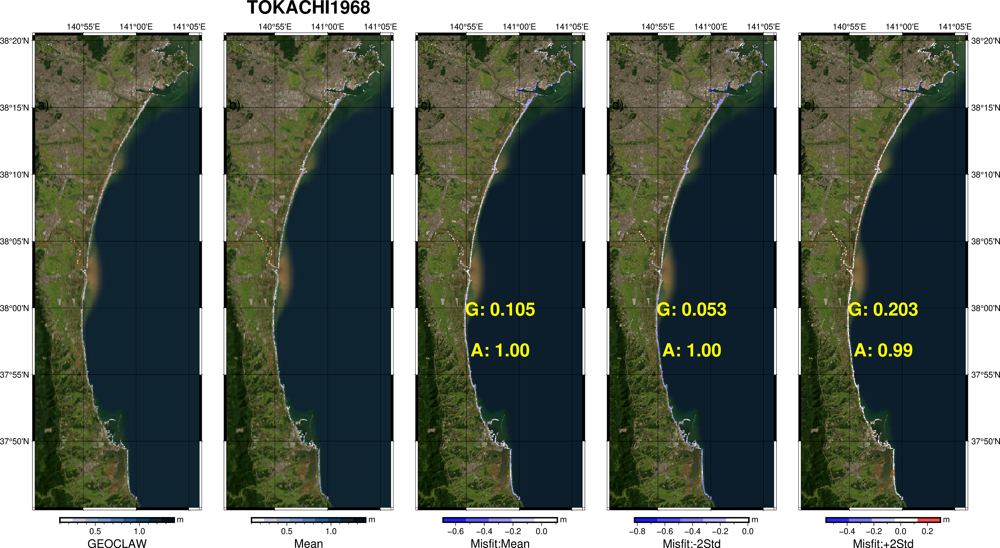

In [2]:
import numpy as np
import pandas as pd
import pygmt
import rioxarray
import contextily as cx

def plot_map(gauge, fold,epoch, region):

    col_name_list = ['Lon', 'Lat', 'Ele', 'FUJI2011_42', 'NANKAI2022', 'SANRIKU1896', 'SANRIKU1933', 'TOKACHI1968', 'YAMAZAKI2018_TPMOD',
                     'SatakeMiniLowerSoft', 'SatakeMiniUpper', 'SatakeMiniUpperSoft', 'SatakeMiniLower']
         
    his_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_data/fgmax{region:04d}_hisflooded.csv'
    his_data = pd.read_csv(his_path, names=col_name_list)
    print('his_data size is {}'.format(his_data.shape))

    # hist_name_list = ['FUJI2011_42','SANRIKU1896','SANRIKU1933','TOKACHI1968','YAMAZAKI2018_TPMOD']   
    hist_name_list = ['TOKACHI1968']   
    neve = len(hist_name_list)
    print('Events plotting are {}'.format(hist_name_list))
    
    # if select events to be plotted manually
    if gauge == '1GaugeRiku':
        site = 'Rikuzentakata'
        subsize = ["12c","15c"]
    elif gauge == '3GaugeIshi':
        site = 'Ishinomaki'
        subsize = ["12c","10c"]
    elif gauge == '3GaugeShio':
        site = 'Sendai'
        subsize = ["8c","20c"]

    # Create a PyGMT figure
    fig = pygmt.Figure()
    region = [his_data['Lon'].min()-0.01, his_data['Lon'].max()+0.01, his_data['Lat'].min()-0.01, his_data['Lat'].max()+0.01]
         
    # Create subplots with shared x and y scales
    with fig.subplot(
        nrows=neve,
        ncols=5,
        subsize = subsize,
        sharex="t+t0.5c",
        sharey=True,
        autolabel=True,
        margins=["0.5c", "3c"],
        frame = ["ag"],
        ):
         # Plot each event
        for i in range(neve):    
            # Get data for the event
            event = hist_name_list[i]
            print('event is {}'.format(event))
            for k in fold:
                predict_path = f'/mnt/beegfs/nragu/tsunami/japan/Paper/MAP/{gauge}/_output/vae_riku_test_{event}_k{k}_e{epoch:04d}.npy'
                predict_k = np.load(predict_path)
                if k == 0:
                    predict = predict_k
                else:
                    predict = np.append(predict,predict_k, axis=0)
            print('predict size is {}'.format(predict.shape))

            eve_data = his_data[hist_name_list[i]].squeeze()
            mean = np.mean(predict, axis=0).squeeze()
            std2 = 2 * np.std(predict, axis=0).squeeze()
            
            # Set the color range for the plot, threshold mask
            colorend = max(eve_data.max(), mean.max())
            mask = ((eve_data > 0.1) | (mean > 0.1))
            
            # Plot observed data
            with fig.set_panel(panel=[i,0]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = eve_data 
                print('range of observed data is max {} min {}'.format(para.max(),para.min()))             
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,                       
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lGEOCLAW", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,1]):
                pygmt.makecpt(cmap="oslo", series=[0.1,colorend,colorend/10],transparency=80,reverse = True)
                para = mean
                print('range of mean predicted data is max {} min {}'.format(para.max(),para.min()))      
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=10,
                            source=cx.providers.Esri.WorldImagery,
                            frame = ["+t{}".format(event)],
                        )
                fig.plot(x=his_data['Lon'][para>0.1],
                            y=his_data['Lat'][para>0.1],
                            fill=para[para>0.1],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMean", "y+lm"],position="JBC+o0c/0.5c+h")

            with fig.set_panel(panel=[i,2]):
                para = eve_data - mean
                print('range of mean misfit is max {} min {}'.format(para.max(),para.min()))      
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:Mean", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                    
            with fig.set_panel(panel=[i,3]):
                para = eve_data - mean - std2
                print('range of -2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            ) 
                fig.colorbar(frame=["x+lMisfit:-2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean - std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean - std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
                
            with fig.set_panel(panel=[i,4]):
                para = eve_data - mean + std2
                print('range of +2std misfit is max {} min {}'.format(para.max(),para.min()))
                pygmt.makecpt(cmap="polar+h0", transparency=80,series=[para.min(),para.max(),(para.max()-para.min())/5]) 
                fig.tilemap(
                            region=region,
                            projection="M8c",
                            zoom=11,
                            source=cx.providers.Esri.WorldImagery,
                        )
                fig.plot(x=his_data['Lon'][mask],
                            y=his_data['Lat'][mask],
                            fill=para[mask],
                            style='s0.05c',
                            cmap = True,
                            transparency =50,
                            region = region,
                            projection="M8c",
                            )
                fig.colorbar(frame=["x+lMisfit:+2Std", "y+lm"],position="JBC+o0c/0.5c+h")
                fig.text(position='TC',offset= "j4c/10c", justify='CT',
                        text=f'G: {Gfit(eve_data, mean + std2):.3f}',
                        font="25p,Helvetica-Bold,Yellow")
                fig.text(position='TC',offset= "j4c/12c", justify='CT',
                        text=f'A: {AQC(eve_data, mean + std2):.2f}',
                        font="25p,Helvetica-Bold,Yellow")
    fig.show()
    fig.savefig(f'./_plots/pred_MAP_{gauge}_f{fold}_hist2.png',dpi=300)

g_list = ['1GaugeRiku', '3GaugeIshi', '3GaugeShio']
plot_map(gauge = g_list[2], fold = [0,1,2,3,4],epoch = 0,region = 1)
